In [1]:
import numpy as np
import pandas as pd
import xarray as xr

import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline

import cartopy
import cartopy.feature as cfeature
import cartopy.crs as ccrs
import warnings; warnings.filterwarnings('ignore')
import matplotlib.path as mpath

from functions import *

#import sys; sys.path.append("..")
#from dataset_manipulation import *
#from palette import *
#from plot import *

from brl_frst_xpsn.utils.coordinate_operations import *
from brl_frst_xpsn.utils.plot.plot import *
from brl_frst_xpsn.utils.plot.palette import *

In [2]:
"""plt.rcParams.update({
"text.usetex": True,
"font.family": 'DejaVu Sans',
"font.serif": ["Computer Modern Roman"],
"font.size": 20})"""
plt.rcParams['font.size'] = '15'

In [3]:
casealias = ['CTRL','IDEAL-ON', 'IDEAL-OFF', 'REAL-ON', 'REAL-OFF']

The total radiative forcing $F_{tot}$ is decomposed into the:
- direct effect $F_{dir}$ from light scattering and absorption by aerosols, 
- cloud radiative forcing $F_{cloud}$ (scattering and absorption by clouds), 
- $F_{rest}$ gather all other possible contributions to the forcing, mainly referring to land surface changes.

\begin{equation}
    F_{tot}=F_{dir}+F_{cloud}+F_{rest}
\end{equation}
The different terms are evaluated as follow:
\begin{equation}
    F_{dir}=F_{tot}-F_{clean}
\end{equation}
\begin{equation}
    F_{cloud}=F_{clean}-F_{clear, clean}
\end{equation}
\begin{equation}
    F_{rest}=F_{clear, clean}
\end{equation}

- $F_{tot}$ is the total radiative flux at top of the atmosphere, 
- $F_{clean}$ stands for "clear air" forcing with no direct aerosol interactions (scattering and absorption), $F_{clear}$ for "clear sky" forcing with no cloud interactions, and 
- $F_{clean, clear}$ is with no aerosol and cloud interaction with radiation. This method is applied separately to the short and long wave radiations, which were then used to evaluate the net forcing. All this terms are calculated by the model as diagnostics and note that they do not account for further decoupling into indirect and semidirect effect on clouds, which would require running simulations where aerosol absorption is neglected (\cite{ghan2013}).

## Ghan components

In [4]:
radiative = load_dataset_dict('RADIATIVE')

Ghan's scomposition completed
Ghan's scomposition completed
Ghan's scomposition completed
Ghan's scomposition completed
Ghan's scomposition completed


In [5]:
"""cmp = sequential_colormap('#ff6f52', '#fafaf4')
fig, axes = plt.subplots(2,2, sharex=True, sharey=True, figsize=[15,12], subplot_kw={'projection':ccrs.Orthographic(0, 90)})#,dpi=100)

for i, case in enumerate(casealias[1:]):
    single_pft_map(radiative[case]['FLNT'].mean('time'),ax = axes.flat[i], extent_lat =45.,
                   title=case, cmap=cmp, show=False)"""

"cmp = sequential_colormap('#ff6f52', '#fafaf4')\nfig, axes = plt.subplots(2,2, sharex=True, sharey=True, figsize=[15,12], subplot_kw={'projection':ccrs.Orthographic(0, 90)})#,dpi=100)\n\nfor i, case in enumerate(casealias[1:]):\n    single_pft_map(radiative[case]['FLNT'].mean('time'),ax = axes.flat[i], extent_lat =45.,\n                   title=case, cmap=cmp, show=False)"

In [6]:
"""def spatial_averages(ds_dict, variable, title, relative = False, vmax_mid = None, **kwargs):
    
    fig, axes = plt.subplots(3,2, figsize=[12,16], subplot_kw={'projection':ccrs.Orthographic(0, 90)})

    #plot_args = dict(cbar_kwargs={'extend':'both'}, **kwargs)

    if kwargs['vmax']: vmax = kwargs['vmax']
    for i, cases in enumerate([['IDEAL-ON', 'CTRL'], ['REAL-ON', 'CTRL'], ['IDEAL-ON', 'IDEAL-OFF'], ['REAL-ON', 'REAL-OFF'], ['IDEAL-OFF', 'CTRL'], ['REAL-OFF', 'CTRL']]):
        if vmax_mid and (i==2 or i ==3): kwargs['vmax'] = vmax_mid
        plot_difference_map(ds_dict, cases[0], cases[1], variable, ax=axes.flat[i], relative=relative, **kwargs)
        if vmax: kwargs['vmax'] = vmax
        
    plt.suptitle(title)
    figtitle = fig_folder+variable
    if relative: figtitle=figtitle+'_relative'
    plt.savefig(figtitle+'.pdf')
    plt.show()"""

"def spatial_averages(ds_dict, variable, title, relative = False, vmax_mid = None, **kwargs):\n    \n    fig, axes = plt.subplots(3,2, figsize=[12,16], subplot_kw={'projection':ccrs.Orthographic(0, 90)})\n\n    #plot_args = dict(cbar_kwargs={'extend':'both'}, **kwargs)\n\n    if kwargs['vmax']: vmax = kwargs['vmax']\n    for i, cases in enumerate([['IDEAL-ON', 'CTRL'], ['REAL-ON', 'CTRL'], ['IDEAL-ON', 'IDEAL-OFF'], ['REAL-ON', 'REAL-OFF'], ['IDEAL-OFF', 'CTRL'], ['REAL-OFF', 'CTRL']]):\n        if vmax_mid and (i==2 or i ==3): kwargs['vmax'] = vmax_mid\n        plot_difference_map(ds_dict, cases[0], cases[1], variable, ax=axes.flat[i], relative=relative, **kwargs)\n        if vmax: kwargs['vmax'] = vmax\n        \n    plt.suptitle(title)\n    figtitle = fig_folder+variable\n    if relative: figtitle=figtitle+'_relative'\n    plt.savefig(figtitle+'.pdf')\n    plt.show()"

In [7]:
for case in casealias:
    radiative[case] = fix_radiative_names(radiative[case])

Ghan's scomposition completed
Ghan's scomposition completed
Ghan's scomposition completed
Ghan's scomposition completed
Ghan's scomposition completed


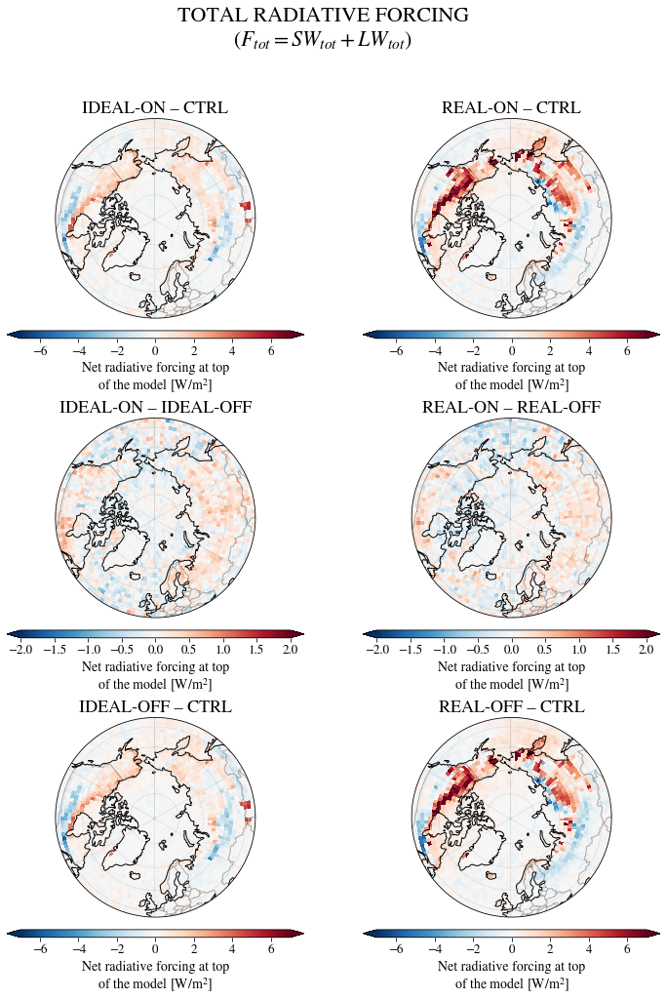

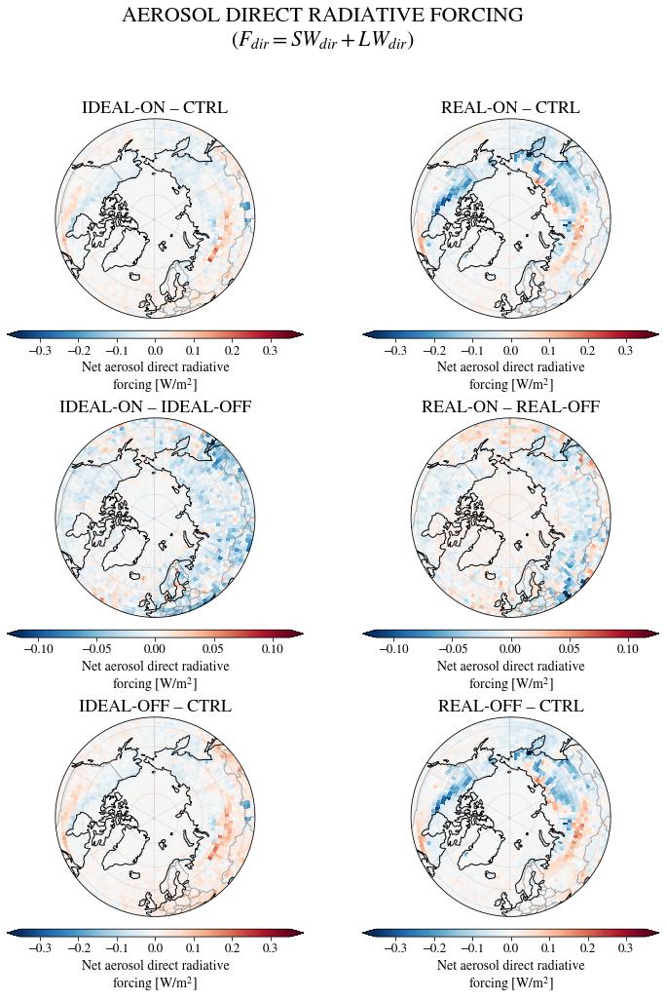

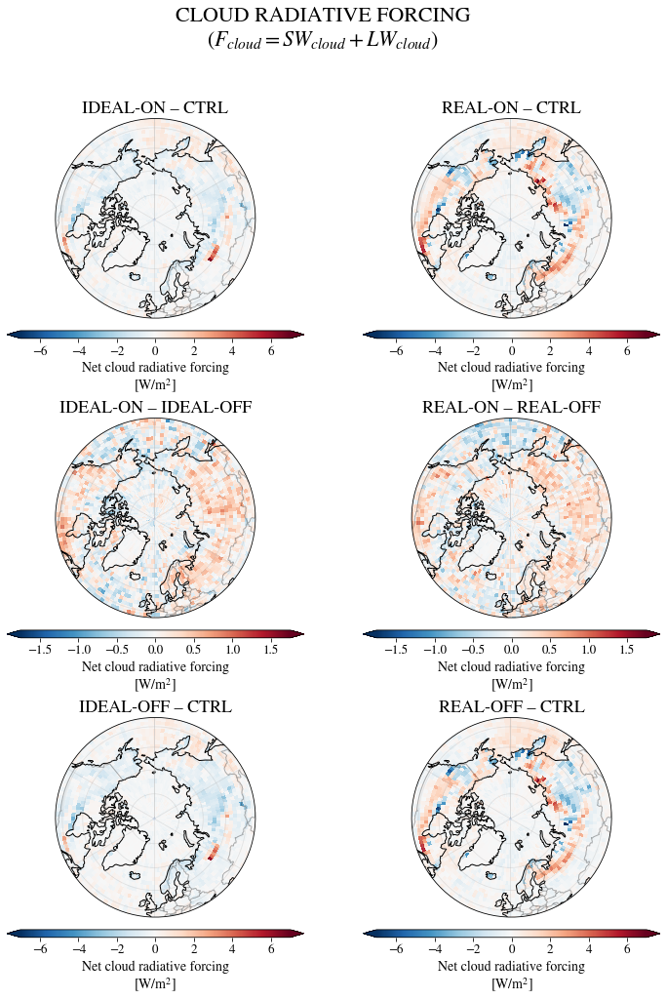

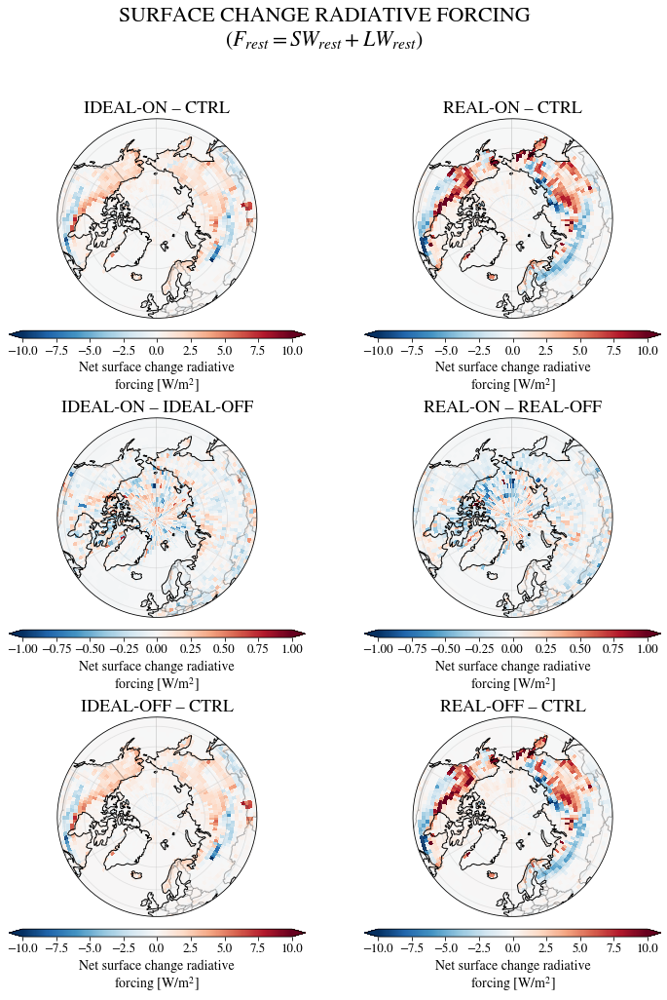

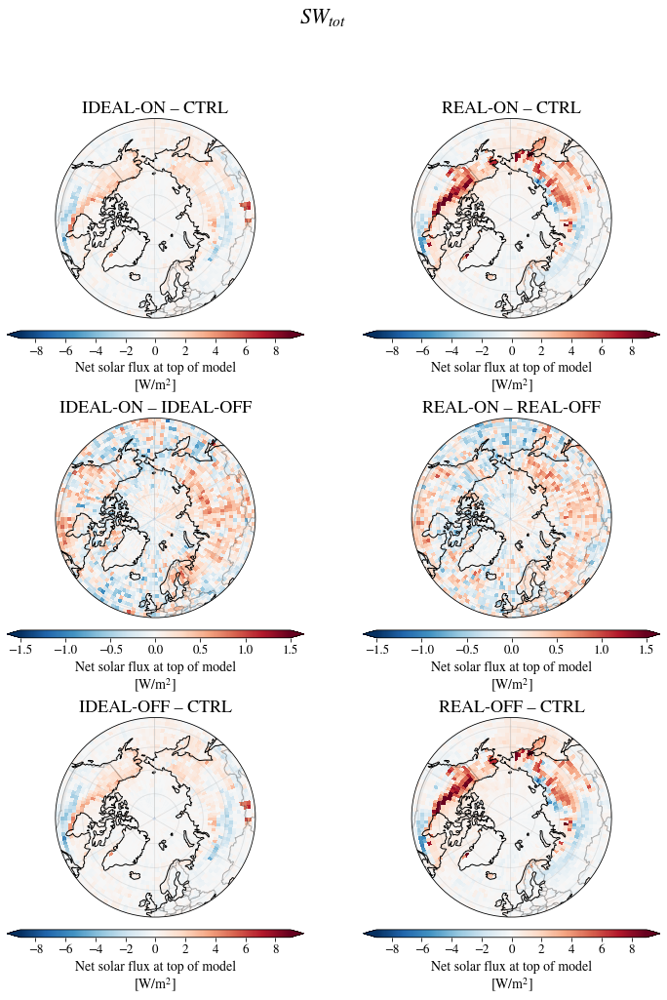

...

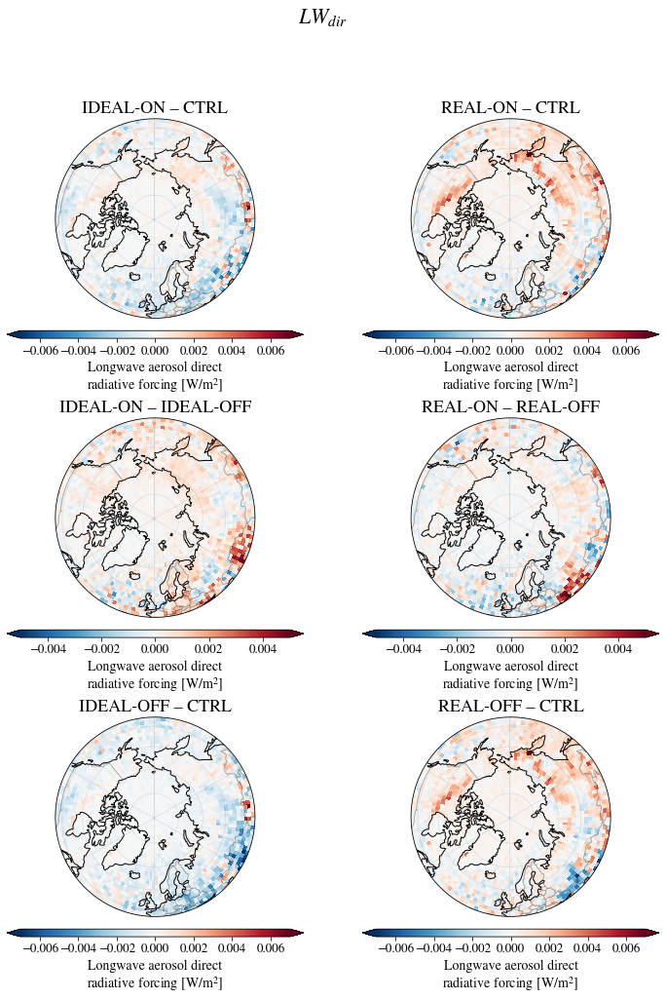

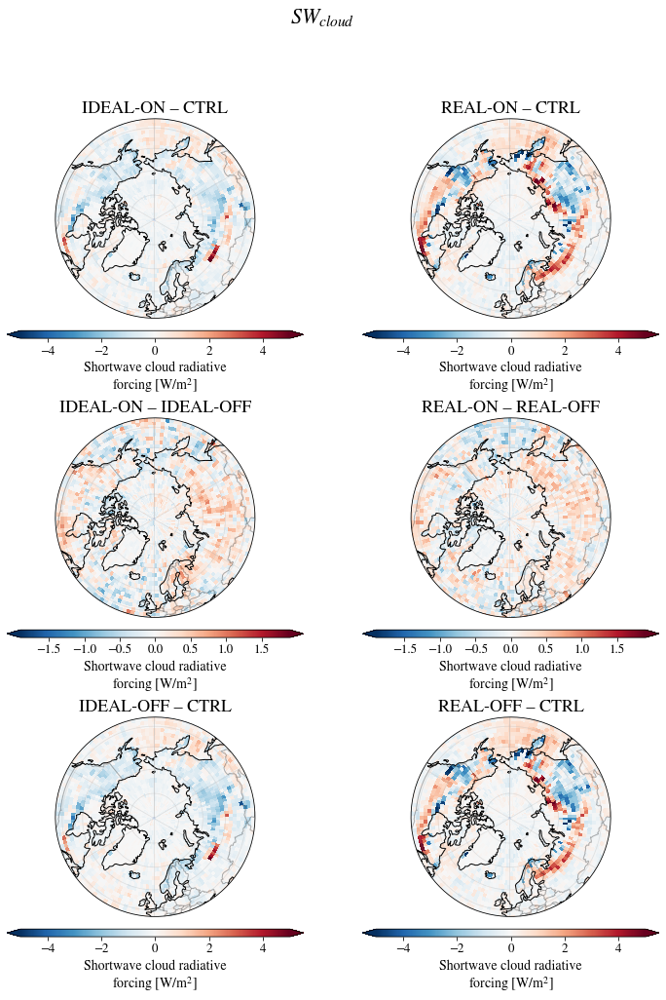

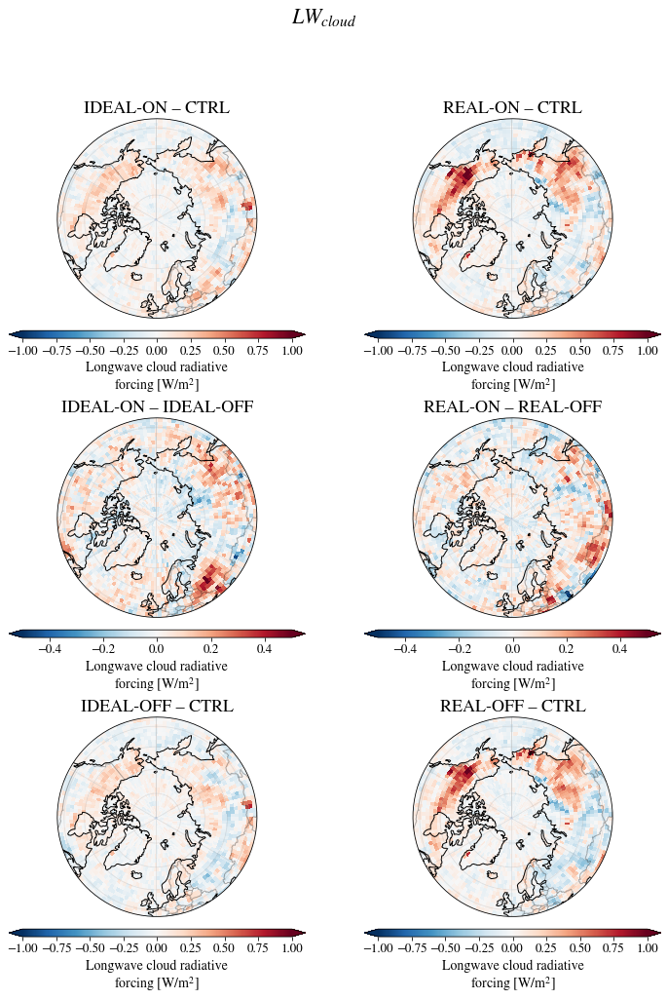

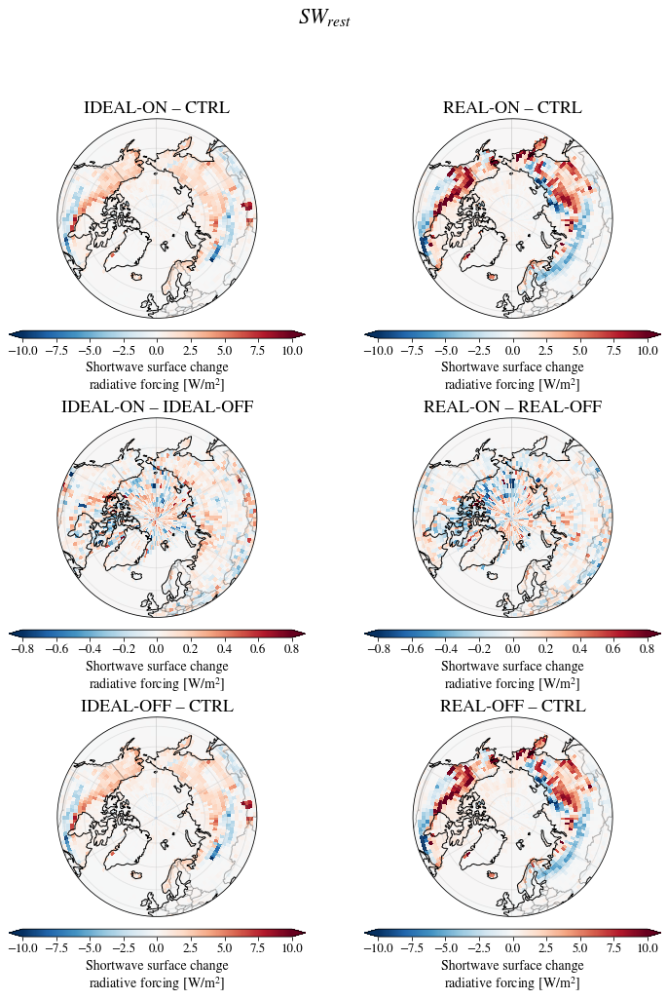

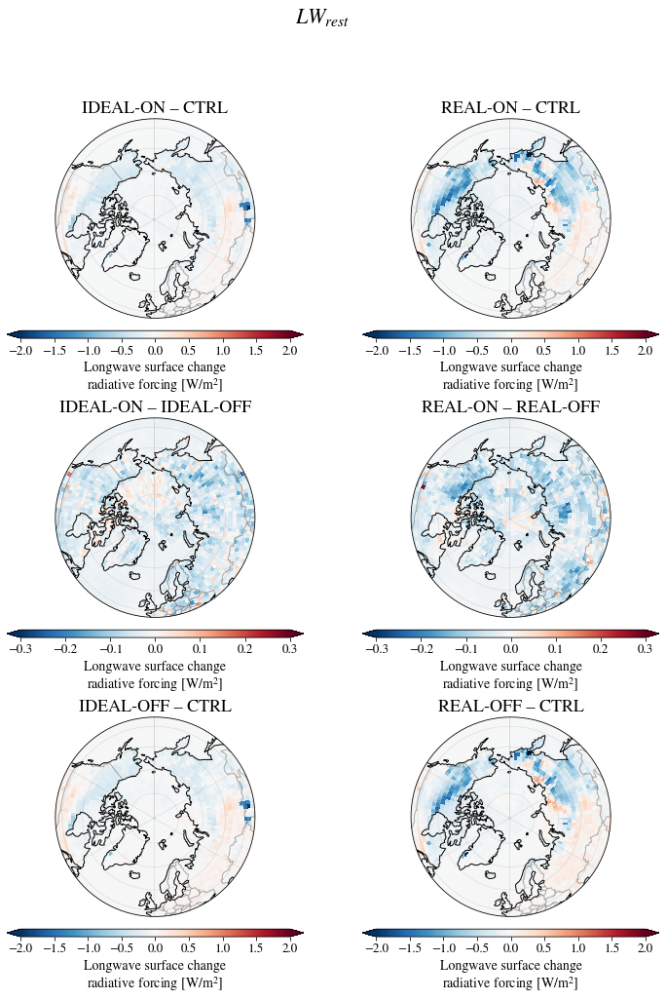

In [10]:
for var in ['FTOT', 'DIR', 'NCFT', 'FREST', 'SWTOT', 'LWTOT', 'SWDIR', 'LWDIR',
            'SWCF', 'LWCF', 'SW_rest', 'LW_rest']:
    if var == 'FTOT': 
        title = r'TOTAL RADIATIVE FORCING'+'\n'+ '($F_{tot} = SW_{tot} + LW_{tot}$)'
        vmax = 7; vmax_mid = 2
    elif var == 'SWTOT': title = r'$SW_{tot}$'; vmax = 9; vmax_mid = 1.5
    elif var == 'LWTOT': title = r'$LW_{tot}$'; vmax = 1; vmax_mid = 0.7
    elif var == 'DIR': 
        title = r'AEROSOL DIRECT RADIATIVE FORCING'+'\n'+ '($F_{dir} = SW_{dir} + LW_{dir}$)'
        vmax =0.35; vmax_mid = 0.115
    elif var == 'SWDIR': title = r'$SW_{dir}$'; vmax=0.4; vmax_mid = 0.115
    elif var == 'LWDIR': title = r'$LW_{dir}$'; vmax=0.007; vmax_mid = 0.005
    elif var == 'NCFT': 
        title = r'CLOUD RADIATIVE FORCING'+'\n'+ '($F_{cloud} = SW_{cloud} + LW_{cloud}$)'
        vmax=7; vmax_mid = 1.75
    elif var == 'SWCF': title = r'$SW_{cloud}$'; vmax=5; vmax_mid = 1.9
    elif var == 'LWCF': title = r'$LW_{cloud}$'; vmax=1; vmax_mid = 0.5
    elif var == 'FREST': 
        title = r'SURFACE CHANGE RADIATIVE FORCING'+'\n'+ '($F_{rest} = SW_{rest} + LW_{rest}$)'
        vmax=10; vmax_mid = 1
    elif var == 'SW_rest': title = r'$SW_{rest}$'; vmax=10; vmax_mid = 0.8
    elif var == 'LW_rest': title = r'$LW_{rest}$'; vmax=2; vmax_mid = 0.3

    else: title = var
    spatial_averages(radiative, var, title, relative=False, vmax = vmax, vmax_mid = vmax_mid, cbar_kwargs=dict(shrink=1))

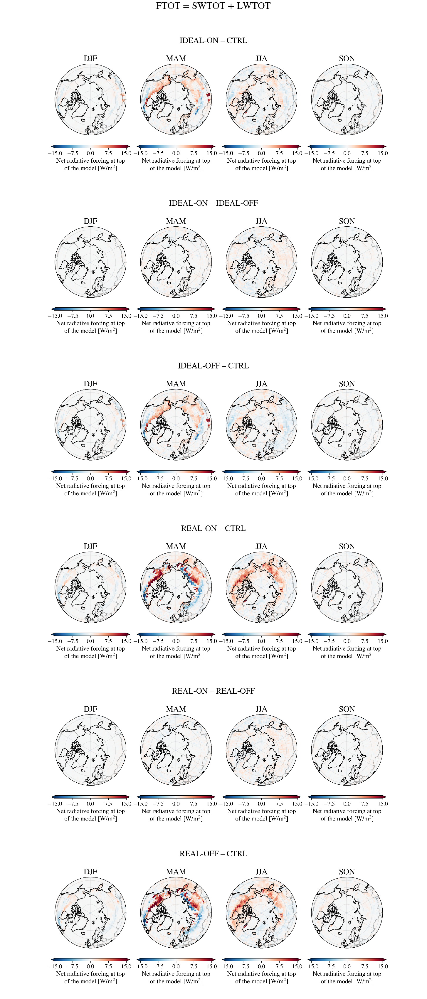

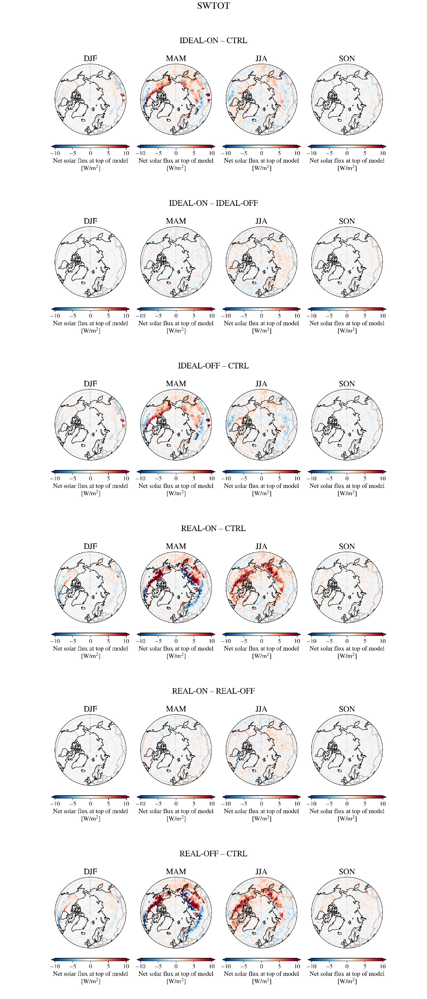

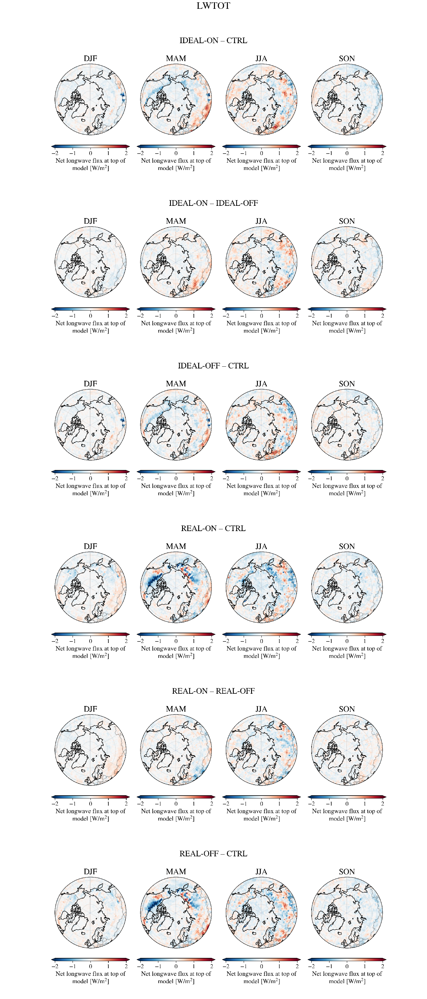

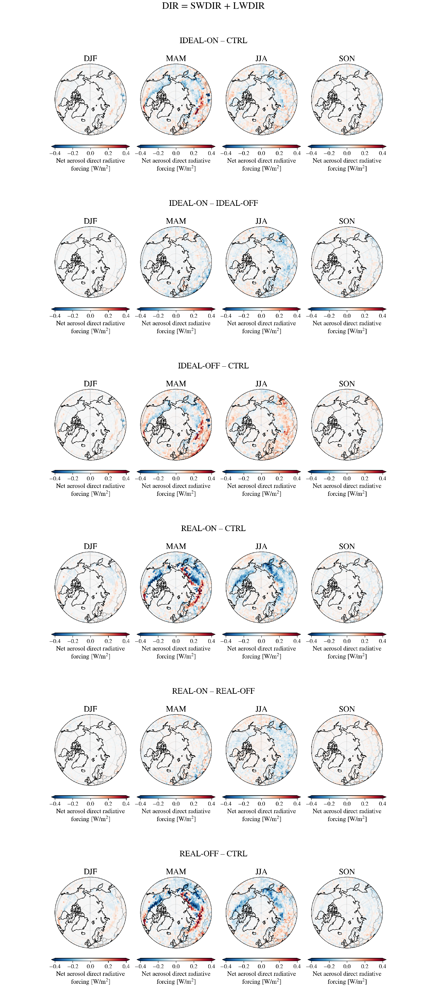

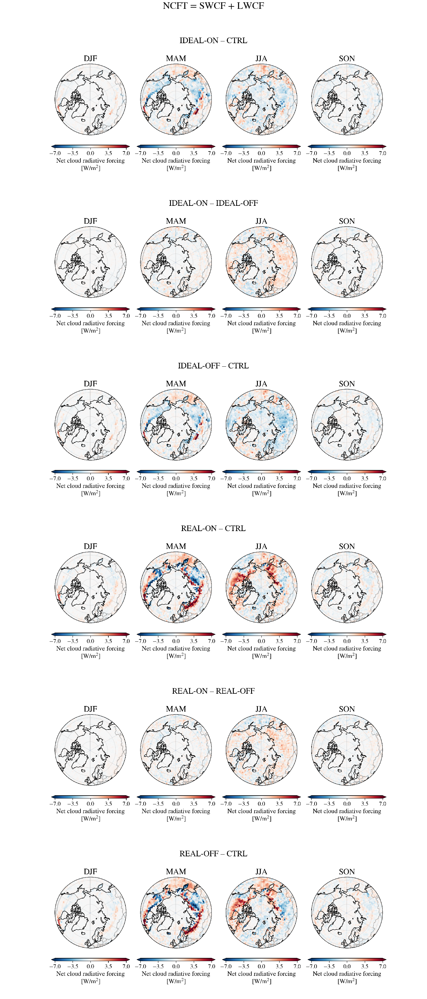

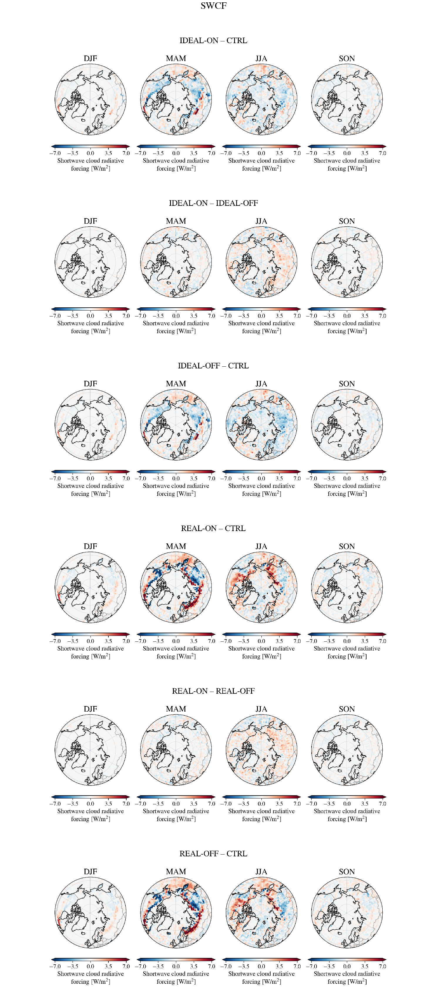

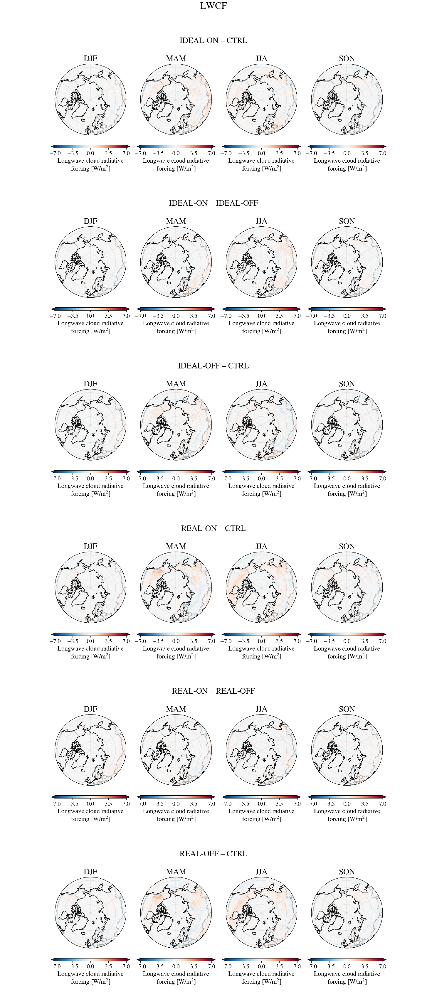

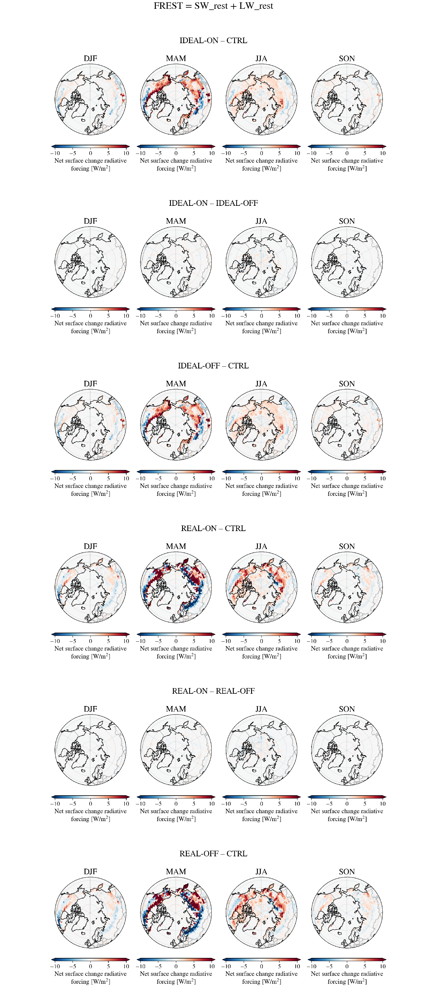

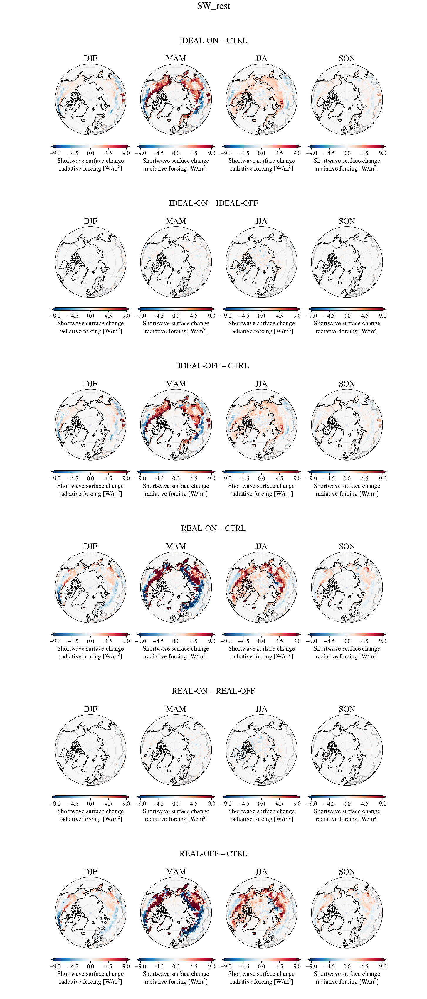

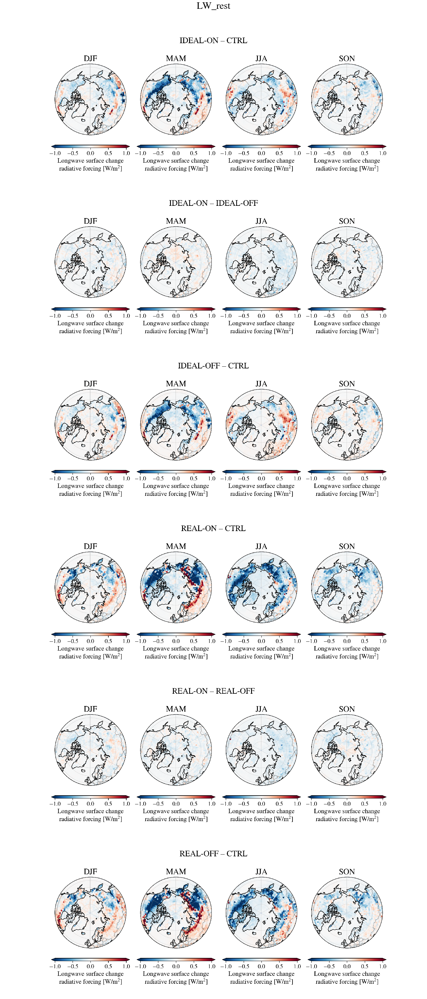

In [9]:
for var in ['FTOT', 'SWTOT', 'LWTOT', 'DIR', 'NCFT', 'SWCF', 'LWCF', 'FREST', 'SW_rest', 'LW_rest']:
    if var == 'FTOT': title = 'FTOT = SWTOT + LWTOT'; vmax = 15
    elif var == 'SWTOT': title = 'SWTOT'; vmax = 10
    elif var == 'LWTOT': title = 'LWTOT'; vmax = 2
    elif var == 'DIR': title = 'DIR = SWDIR + LWDIR'; vmax =0.4
    elif var == 'NCFT': title = 'NCFT = SWCF + LWCF'; vmax=7
    elif var == 'SW_rest': title = var; vmax=9
    elif var == 'LW_rest': title = var; vmax=1
    elif var == 'FREST': title = 'FREST = SW_rest + LW_rest'; vmax=10
    else: title = var
    #spatial_averages(radiative, var, title, relative=False, vmax = vmax)
    spatial_averages_4seasons(radiative, var, title, relative = False, vmax=vmax)

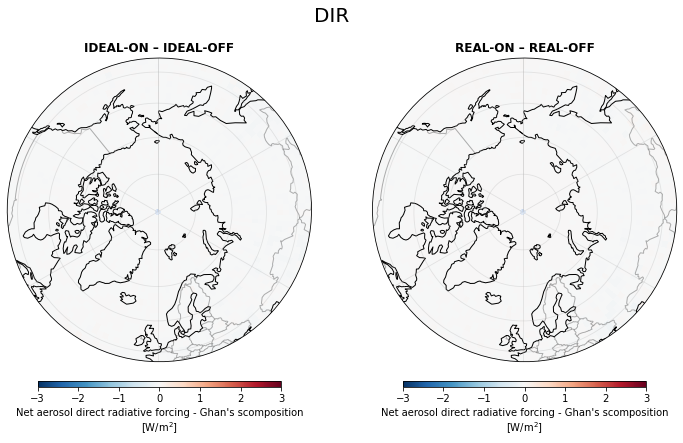

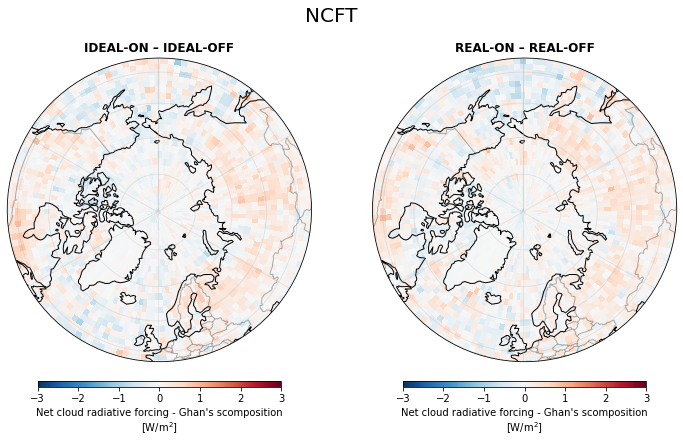

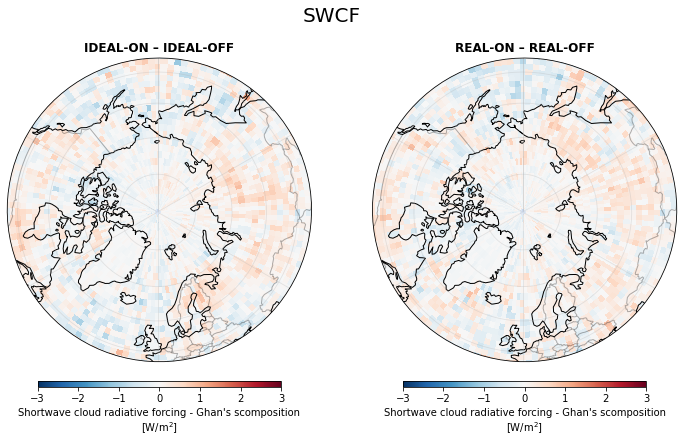

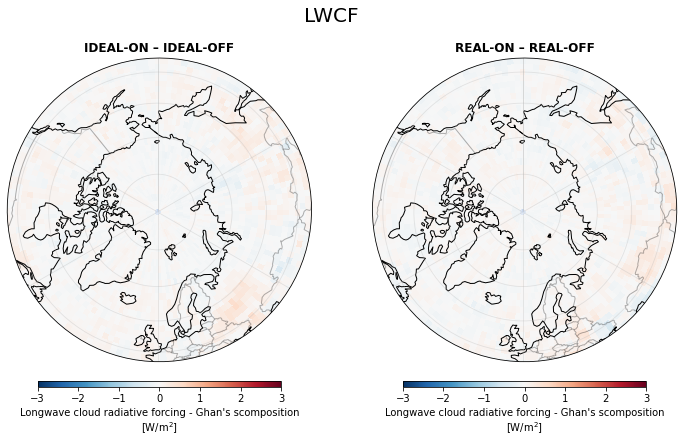

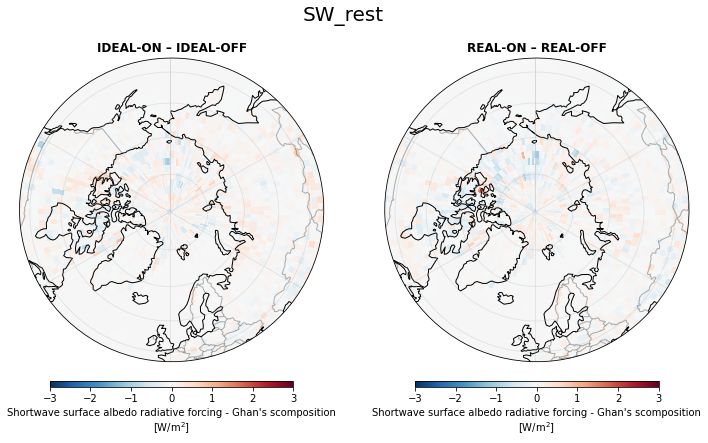

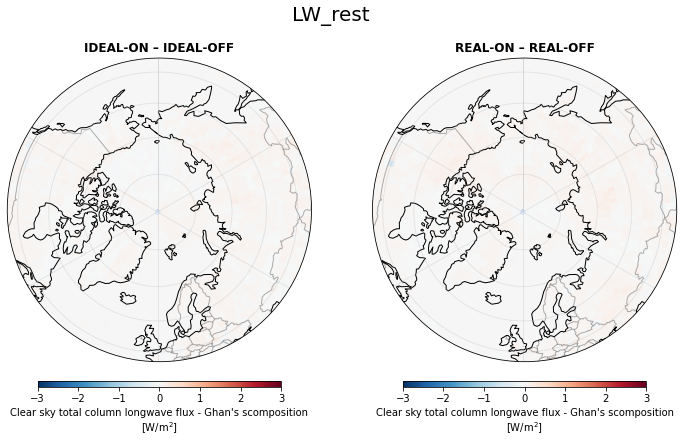

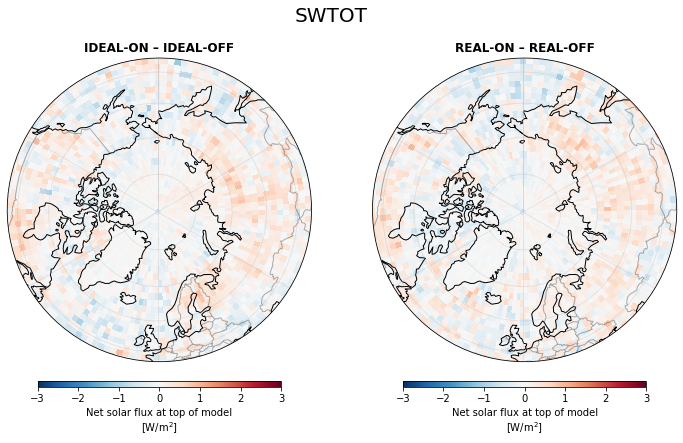

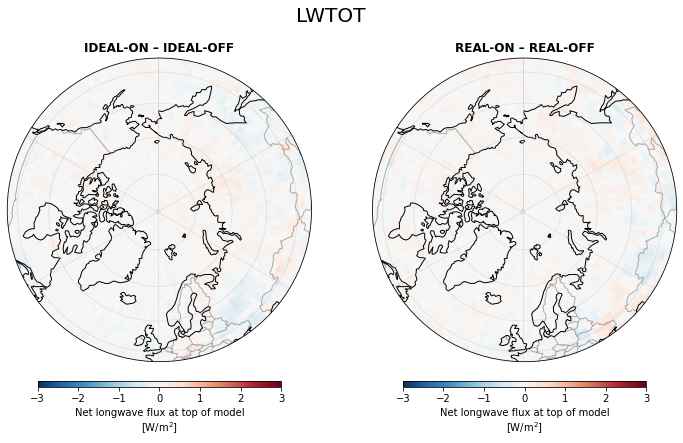

In [22]:
for var in ['DIR', 'NCFT', 'SWCF', 'LWCF', 'SW_rest', 'LW_rest', 'FSNT', 'FLNT']:

    fig, axes = plt.subplots(1,2, sharex=True, sharey=True, figsize=[12,7], 
                             subplot_kw={'projection':ccrs.Orthographic(0, 90)})#,dpi=100)

    variable=var
    title=var
    if var == 'FSNT': title = 'SWTOT'
    if var == 'FLNT': title = 'LWTOT'
    plot_difference(radiative, 'IDEAL-ON', 'IDEAL-OFF', variable, ax=axes.flat[0], vmax=3)
    plot_difference(radiative, 'REAL-ON', 'REAL-OFF', variable, ax=axes.flat[1], vmax=3)
    plt.suptitle(title, size=20)
    plt.show()

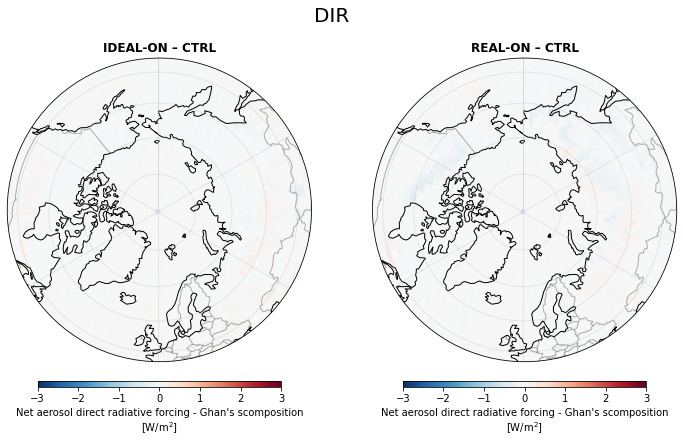

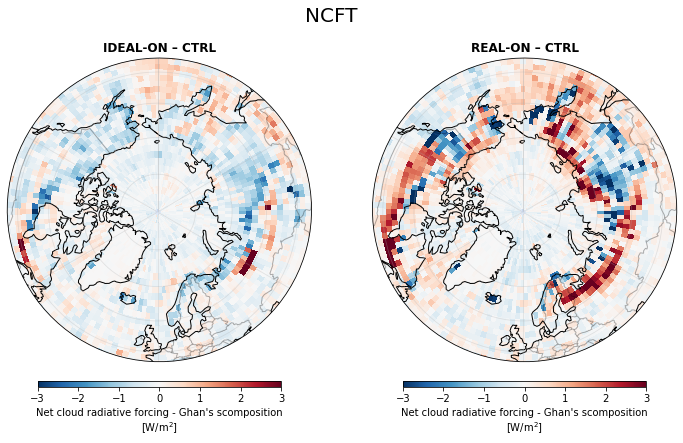

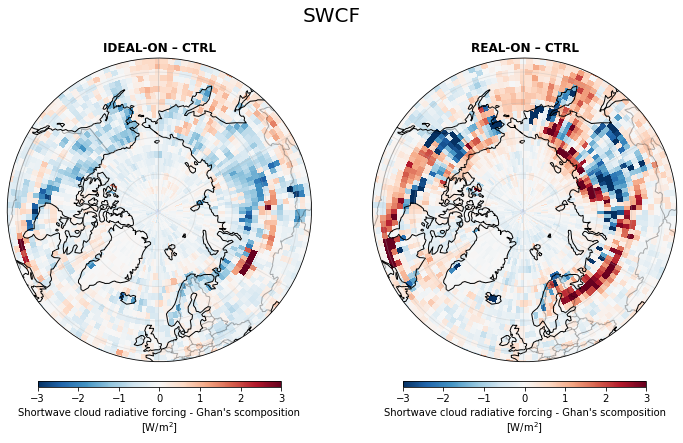

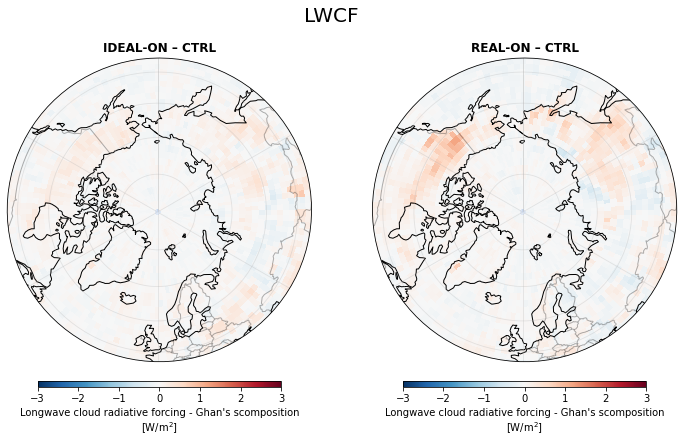

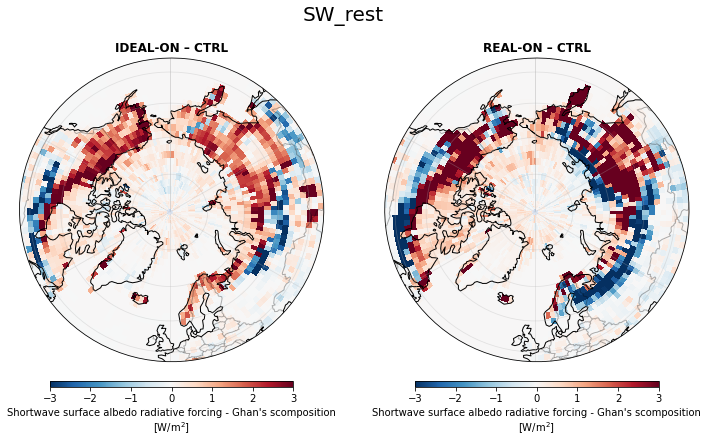

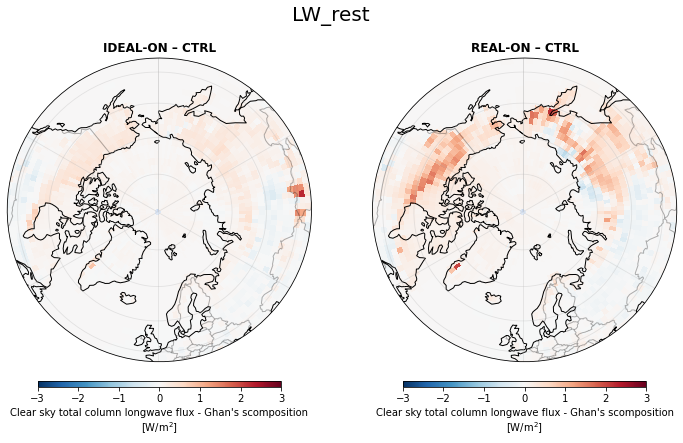

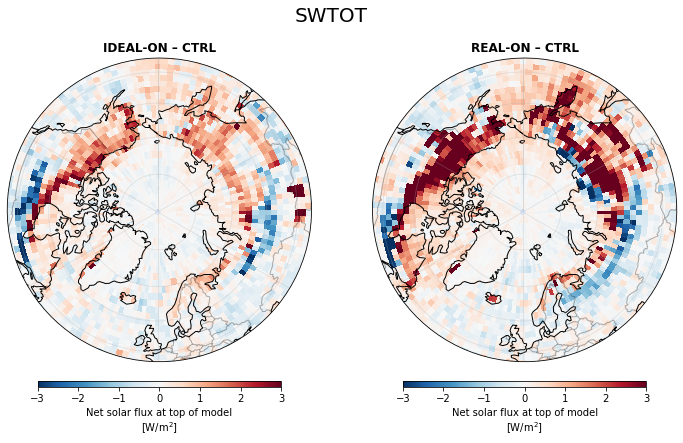

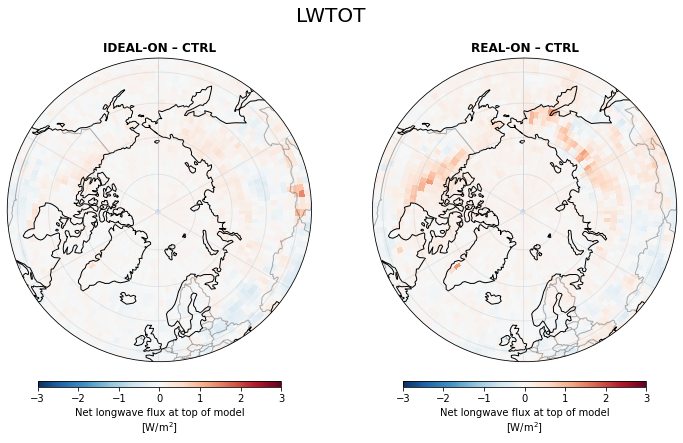

In [23]:
for var in ['DIR', 'NCFT', 'SWCF', 'LWCF', 'SW_rest', 'LW_rest', 'FSNT', 'FLNT']:

    fig, axes = plt.subplots(1,2, sharex=True, sharey=True, figsize=[12,7], 
                             subplot_kw={'projection':ccrs.Orthographic(0, 90)})#,dpi=100)

    variable=var
    title=var
    if var == 'FSNT': title = 'SWTOT'
    if var == 'FLNT': title = 'LWTOT'
    plot_difference(radiative, 'IDEAL-ON', 'CTRL', variable, ax=axes.flat[0], vmax=3)
    plot_difference(radiative, 'REAL-ON', 'CTRL', variable, ax=axes.flat[1], vmax=3)
    plt.suptitle(title, size=20)
    plt.show()

In [ ]:
def plot_difference(da_dict, case1, case2, variable, ax = None, lev=False, **kwargs):
    
    diff = (da_dict[case1][variable].mean('time')-da_dict[case2][variable].mean('time'))#/da_dict[case2][variable].groupby('time.year').sum('time').mean('year')
    if lev: diff=diff.sum('lev')#.where(da_dict[case1].LANDFRAC.mean('time')>0.)
    single_pft_map(diff, ax = ax, title=case1+' – '+case2, cmap='RdBu_r', extent_lat =45.,**kwargs)
        
def plot_difference_by_season(da_dict, case1, case2, variable, title, lev=False,**kwargs):
    seasons = ['DJF', 'MAM', 'JJA', 'SON']
    
    diff = (da_dict[case1][variable].groupby('time.season').mean('time')-da_dict[case2][variable].groupby('time.season').mean('time'))
    if lev: diff=diff.sum('lev').where(da_dict[case1].LANDFRAC.mean('time')>0.)
        
    fig, axes = plt.subplots(1,4, figsize=[17,5], subplot_kw={'projection':ccrs.Orthographic(0, 90)})#,dpi=100)
    
    for i, season in enumerate(seasons):
        single_pft_map(diff.sel(season=season), ax = axes.flat[i], title=season, cmap='RdBu_r', extent_lat =45.,**kwargs)
    plt.suptitle(title+': '+case1+' – '+case2, size=15)
    plt.show()

In [ ]:
fig_folder = '../../figures/results/'
from textwrap import wrap
#––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––#
def set_colorbar(ds, kwargs):
    if 'vmax' in list(kwargs.keys()):
        vmax = kwargs['vmax']
        kwargs['vmin'] = - vmax
    if 'cbar_kwargs' in list(kwargs.keys()):
        kwargs['cbar_kwargs']['ticks'] = [-vmax, -vmax*0.5, 0, vmax*0.5, vmax]
    if not 'norm' in list(): kwargs['norm'] = MidpointNormalize(midpoint=0.)
    #if 'levels' in list(kwargs.keys()):
        #ds = ds.where(ds!=0.)
#––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––#
def plot_difference_map_winter_summer(axes, da_dict, case1, case2, variable, seasons = ['DJF', 'JJA'], boreal_lat=45., relative = False, **kwargs):
    
    da1 = da_dict[case1][variable].groupby('time.season').mean('time')
    da2 = da_dict[case2][variable].groupby('time.season').mean('time')
    
    if variable=='ACTNL' or variable=='ACTREL':
        da1 = da_dict[case1][variable].groupby('time.season').mean('time')/da_dict[case1]['FCTL'].groupby('time.season').mean('time')
        da2 = da_dict[case2][variable].groupby('time.season').mean('time')/da_dict[case2]['FCTL'].groupby('time.season').mean('time')
    diff = (da1-da2)
    if relative:
        diff = diff/da2*100
        if not 'vmax' in list(kwargs.keys()): kwargs = dict(vmax=100, **kwargs)
    
    if variable=='N_AER': diff=diff.isel(lev=-1)
        
    set_colorbar(diff, kwargs)

    for i, season in enumerate(seasons):
        boreal_map(diff.sel(season=season), ax=axes.flat[i],title=season, cmap='RdBu_r', extent_lat = boreal_lat, units = '%' if relative else None, **kwargs)
    plt.subplots_adjust(bottom=0.3, top=0.8)
    plt.suptitle(case1+' – '+case2, y=0.9,size=18)
    plt.tight_layout()
    
    
    
#––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––––#
def spatial_averages_4seasons(ds_dict, variable, title, figsize=[20,60], dpi=300, relative = False, cbar_kwargs = {},**kwargs):
    seasons = ['DJF', 'MAM','JJA', 'SON']
    
    backend = mpl.get_backend()
    mpl.use('agg')

    plot_args = dict(nrows=1, ncols=4, figsize=[figsize[0]/2.*1.3, figsize[1]/12.], dpi=dpi, subplot_kw={'projection':ccrs.Orthographic(0, 90)})
    
    figs = []
    axes = []
    for i, cases in enumerate([['IDEAL-ON', 'CTRL'], ['REAL-ON', 'CTRL'], ['IDEAL-ON', 'IDEAL-OFF'], ['REAL-ON', 'REAL-OFF'], ['IDEAL-OFF', 'CTRL'], ['REAL-OFF', 'CTRL']]):
        fig, ax = plt.subplots(**plot_args)
        axes.append(ax)
        plot_difference_map_winter_summer(axes[i], ds_dict, *cases, variable, seasons = seasons, relative = relative, cbar_kwargs=dict(shrink=1.1, aspect=25, **cbar_kwargs), **kwargs)
        figs.append(fig)
    
    a_list = []
    for fig in figs:
        c = fig.canvas
        c.draw()
        a_list.append(np.array(c.buffer_rgba()))
        
    a = np.vstack(a_list)
        
    mpl.use(backend)
    fig,ax = plt.subplots(figsize=figsize)
    fig.subplots_adjust(0, 0, 1, 1)
    ax.set_axis_off()
    ax.matshow(a)
    plt.suptitle(title, size=33, y=0.9)
    figtitle = fig_folder+variable+'_4seasons'
    if relative: figtitle=figtitle+'_4seasons_relative'
    plt.savefig(figtitle+'.pdf')
    plt.show()